## Faezeh Yazdi Capstone Project - Food Recomendation System

## Notebook : Classification Models
This notebook aims to predict the average rating for each recipe, based on its features.

**Road Map**
1. Classification with text data
 just description column.
 1. bag of words
     - KNN
     - Logistic reg
     - desicion tree
 2. Tf-Idf
     - KNN
     - Logistic reg
     - desicion tree
     
2. Classification with all features including numeric and text




### Load data

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction import text
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV

In [3]:
# Set the maximum number of columns to display to None
pd.set_option('display.max_columns', None)

In [4]:
#read data
df = pd.read_parquet("Transformed Data/cleanedRecipedf.parquet")

In [5]:
df.shape

(269038, 27)

In [6]:
df.head()

,RecipeId,Name,AuthorId,AuthorName,DatePublished,Description,Images,RecipeCategory,Keywords,RecipeIngredientQuantities,RecipeIngredientParts,AggregatedRating,ReviewCount,Calories,FatContent,SaturatedFatContent,CholesterolContent,SodiumContent,CarbohydrateContent,FiberContent,SugarContent,ProteinContent,RecipeInstructions,PrepTimeHours,CookingTimeHours,TotalTimeHours,CaloriesCategory
0,38,Low-Fat Berry Blue Frozen Dessert,1533,Dancer,1999-08-09 21:46:00+00:00,Make and share this Low-Fat Berry Blue Frozen ...,[https://img.sndimg.com/food/image/upload/w_55...,Frozen Desserts,"[Dessert, Low Protein, Low Cholesterol, Health...","[4, 1⁄4, 1, 1]","[blueberries, granulated sugar, vanilla yogurt...",4.5,4.0,170.9,2.5,1.3,8.0,29.8,37.1,3.6,30.2,3.2,"[Toss 2 cups berries with sugar., Let stand fo...",0.750000,24.000000,24.750000,lessthan550
1,39,Biryani,1567,elly9812,1999-08-29 13:12:00+00:00,Make and share this Biryani recipe from Food.com.,[https://img.sndimg.com/food/image/upload/w_55...,Chicken Breast,"[Chicken Thigh & Leg, Chicken, Poultry, Meat, ...","[1, 4, 2, 2, 8, 1⁄4, 8, 1⁄2, 1, 1, 1⁄4, 1⁄4, 1...","[saffron, milk, hot green chili peppers, onion...",3.0,1.0,1110.7,58.8,16.6,372.8,368.4,84.4,9.0,20.4,63.4,[Soak saffron in warm milk for 5 minutes and p...,4.000000,0.416667,4.416667,between550-4K
2,40,Best Lemonade,1566,Stephen Little,1999-09-05 19:52:00+00:00,This is from one of my first Good House Keepi...,[https://img.sndimg.com/food/image/upload/w_55...,Beverages,"[Low Protein, Low Cholesterol, Healthy, Summer...","[1 1⁄2, 1, None, 1 1⁄2, None, 3⁄4]","[sugar, lemons, rind of, lemon, zest of, fresh...",4.5,10.0,311.1,0.2,0.0,0.0,1.8,81.5,0.4,77.2,0.3,"[Into a 1 quart Jar with tight fitting lid, pu...",0.500000,0.083333,0.583333,lessthan550
3,41,Carina's Tofu-Vegetable Kebabs,1586,Cyclopz,1999-09-03 14:54:00+00:00,This dish is best prepared a day in advance to...,[https://img.sndimg.com/food/image/upload/w_55...,Soy/Tofu,"[Beans, Vegetable, Low Cholesterol, Weeknight,...","[12, 1, 2, 1, 10, 1, 3, 2, 2, 2, 1, 2, 1⁄2, 1⁄...","[extra firm tofu, eggplant, zucchini, mushroom...",4.5,2.0,536.1,24.0,3.8,0.0,1558.6,64.2,17.3,32.1,29.3,"[Drain the tofu, carefully squeezing out exces...",24.000000,0.333333,24.333333,lessthan550
4,42,Cabbage Soup,1538,Duckie067,1999-09-19 06:19:00+00:00,Make and share this Cabbage Soup recipe from F...,[https://img.sndimg.com/food/image/upload/w_55...,Vegetable,"[Low Protein, Vegan, Low Cholesterol, Healthy,...","[46, 4, 1, 2, 1]","[plain tomato juice, cabbage, onion, carrots, ...",4.5,11.0,103.6,0.4,0.1,0.0,959.3,25.1,4.8,17.7,4.3,"[Mix everything together and bring to a boil.,...",0.333333,0.500000,0.833333,lessthan550


In [7]:
df['Description'][0]

'Make and share this Low-Fat Berry Blue Frozen Dessert recipe from Food.com.'

# Classification with just `Descriptions`

X : description<br>
y : rating

### Target Variable:
lets see the distribution of our target column.

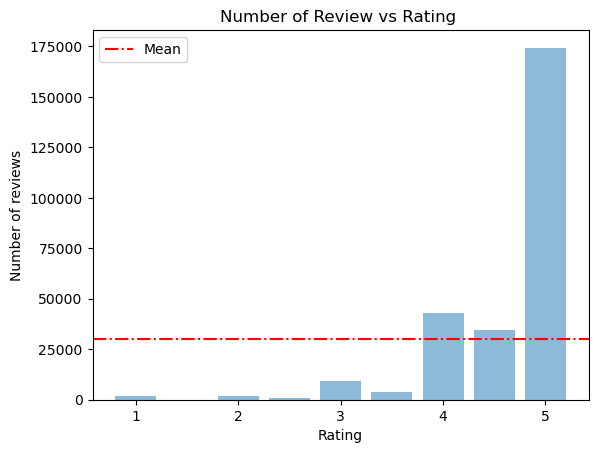

In [7]:
plt.figure()
plt.bar(df["AggregatedRating"].value_counts().index, df["AggregatedRating"].value_counts().values, alpha=0.5, width= 0.4)
plt.ylabel('Number of reviews')
plt.xlabel('Rating')
plt.title('Number of Review vs Rating ')
plt.axhline(df["AggregatedRating"].value_counts().values.mean(), c='r', linestyle='-.',label='Mean')
plt.legend()
plt.show()

To be able to predict more accurately we group data to two categories. One less than 4.5 and the other 5.

In [10]:
# lets make a categorize column in our dataset
df["Target"] = np.where(df["AggregatedRating"]>4.5,1,0)


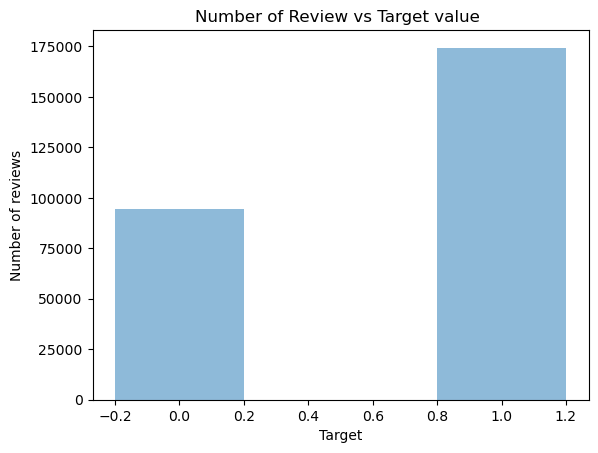

In [9]:
#distribution of categorized columns
plt.figure()
plt.bar(df["Target"].value_counts().index, df["Target"].value_counts().values, alpha=0.5, width= 0.4)
plt.ylabel('Number of reviews')
plt.xlabel('Target')
plt.title('Number of Review vs Target value ')
plt.show()

As we can see the data is very unbalanced and this may lead to bias in the model. lets balance data
## Balance the data 
 
### under sampling

As dataset is large enough we can sample our majority group to become the same size as our minor class.

In [10]:
# each group size
df['Target'].value_counts()

1    174369
0     94669
Name: Target, dtype: int64

In [11]:
#sample the 1 class
df_1_sample = df[df['Target']==1].sample(n=94669, replace=False, random_state=1)

#sanity check
df_1_sample.shape

(94669, 28)

In [12]:
#define zero class
df_0_sample = df[df['Target']==0]
df_0_sample.shape

(94669, 28)

In [13]:
#combine them to one dataset
df_balance = df_0_sample.append(df_1_sample, ignore_index=True)

df_balance.shape

/var/folders/bg/nwrfqr3x53x6dwwjtgkf3bl80000gn/T/ipykernel_1864/1159941143.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_balance = df_0_sample.append(df_1_sample, ignore_index=True)


(189338, 28)

In [10]:
df_balance.to_parquet('Transformed Data/Recipedf_balanced.parquet', index=False)

---
## split data

For the first model we will just use the description column and try to predict by that.

In [15]:

X = df_balance["Description"]
y = df_balance["Target"]

#split to test and train and stratify with rating
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=25,stratify=df_balance["Target"])

## Tokenizer

In [16]:
#import:
#stemmer
import nltk
stemmer = nltk.stem.PorterStemmer()
# import stopwords
nltk.download('stopwords')
from nltk.corpus import stopwords 
# import punctuation list
import string



# define custome tokenizer
ENGLISH_STOP_WORDS = stopwords.words('english')
def my_tokenizer(sentence):
    # remove punctuation and set to lower case
    for punctuation_mark in string.punctuation:
        sentence = sentence.replace(punctuation_mark,'').lower()

    # split sentence into words
    listofwords = sentence.split(' ')
    listofstemmed_words = []
    
    # remove stopwords and any tokens that are just empty strings
    for word in listofwords:
        if (not word in ENGLISH_STOP_WORDS) and (word!=''):
            # Stem words
            stemmed_word = stemmer.stem(word)
            listofstemmed_words.append(stemmed_word)

    return listofstemmed_words



[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/Arianayazdi/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Vectorizing : *bag of words*

In [17]:
#vectorizing
bagofwords = CountVectorizer(min_df=0.05,max_df=20000,
                             tokenizer = my_tokenizer)
bagofwords.fit(X_train)

X_train_transformed_bgw = bagofwords.transform(X_train)
X_test_transformed_bgw = bagofwords.transform(X_test)

/Users/arianayazdi/opt/anaconda3/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


In [18]:
#data frame of words frequency in whole dataset
bgw_df = pd.DataFrame({'Frequency':X_train_transformed_bgw.toarray().sum(axis=0)},index=bagofwords.get_feature_names())


/Users/arianayazdi/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


<Figure size 640x480 with 0 Axes>

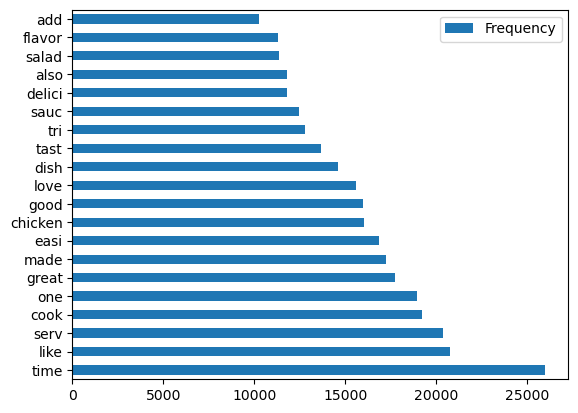

In [19]:
#plot the most frequent words
plt.figure()
bgw_df.sort_values('Frequency',ascending = False).head(20).plot(kind='barh')
plt.show()

We can see the most frequent words in the description of food recipes in the above chart. It is interesting that  word time is the most frequent. It might be because recipe author think the time matters for users. we can check this in furture by using logistic regression to see if it is significantly effecting.

Now lets try TFIDF as vectorizer and compare the results.

## Vectorizing : *TFIDF*

In [20]:
# tfidf vectorizing
tfidf = TfidfVectorizer(min_df=5,
                        tokenizer=my_tokenizer)
tfidf.fit(X_train)

X_train_transformed_tfidf = tfidf.transform(X_train)
X_test_transformed_tfidf = tfidf.transform(X_test)

X_train_transformed_tfidf.shape

/Users/arianayazdi/opt/anaconda3/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(151470, 12326)

Now we can run different classification models on both types of vectorizing and comparing the results.

## Models with just description column

## Log Reg

In [21]:
#log reg with bagofwords
C_values = [0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]

train_accu_logReg_bgw = []
test_accu_logReg_bgw = []
for i in C_values:
    logreg = LogisticRegression(C = i, max_iter = 100000)
    logreg.fit(X_train_transformed_bgw, y_train)
    train_accu_logReg_bgw.append(logreg.score(X_train_transformed_bgw, y_train))
    test_accu_logReg_bgw.append(logreg.score(X_test_transformed_bgw, y_test))
    
    
    
    
#log reg with TFIDF
C_values = [0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]

train_accu_logReg_tfidf = []
test_accu_logReg_tfidf = []

for i in C_values:
    logreg = LogisticRegression(C = i, max_iter = 100000)
    logreg.fit(X_train_transformed_tfidf, y_train)
    train_accu_logReg_tfidf.append(logreg.score(X_train_transformed_tfidf, y_train))
    test_accu_logReg_tfidf.append(logreg.score(X_test_transformed_tfidf, y_test))

<Figure size 640x480 with 0 Axes>

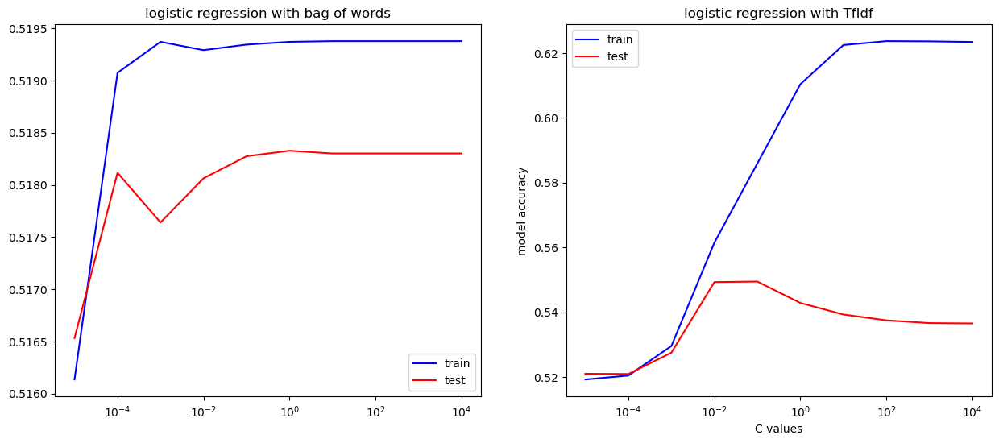

In [22]:
plt.figure()
plt.subplots(1,2, figsize=(15,6))

plt.subplot(1,2,1)
plt.plot(C_values, train_accu_logReg_bgw, c='b', label='train')
plt.plot(C_values, test_accu_logReg_bgw, c='r', label='test')
plt.xscale('log')
plt.legend()
plt.title("logistic regression with bag of words")


plt.subplot(1,2,2)
plt.plot(C_values, train_accu_logReg_tfidf, c='b', label='train')
plt.plot(C_values, test_accu_logReg_tfidf, c='r', label='test')
plt.xscale('log')
plt.xlabel('C values')
plt.ylabel('model accuracy')
plt.legend()
plt.title("logistic regression with TfIdf")


plt.show()

Our test accuracy for the model uses TFIDF is slightly higher than the one with bag of words. Moreover, the best C value for TFIDF model is 0.01 and for the bagofwords model is 0.0001 and after that model overfits.

## Decision Tree

In [23]:
depths = [2,4,6,8,10,20,25]

# Dt with bagof words
train_accu_Dt_bgw = []
test_accu_Dt_bgw = []

for max_depth in depths:
    DT = DecisionTreeClassifier(max_depth=max_depth)
    DT.fit(X_train_transformed_bgw, y_train)
    train_accu_Dt_bgw.append(DT.score(X_train_transformed_bgw,y_train))
    test_accu_Dt_bgw.append(DT.score(X_test_transformed_bgw,y_test))


#Dt with Tfidf
train_accu_Dt_tfidf = []
test_accu_Dt_tfidf = []

for max_depth in depths:
    DT = DecisionTreeClassifier(max_depth=max_depth)
    DT.fit(X_train_transformed_tfidf, y_train)
    train_accu_Dt_tfidf.append(DT.score(X_train_transformed_tfidf,y_train))
    test_accu_Dt_tfidf.append(DT.score(X_test_transformed_tfidf,y_test))

Text(0.5, 1.0, 'Decision tree with Tfidf')

<Figure size 640x480 with 0 Axes>

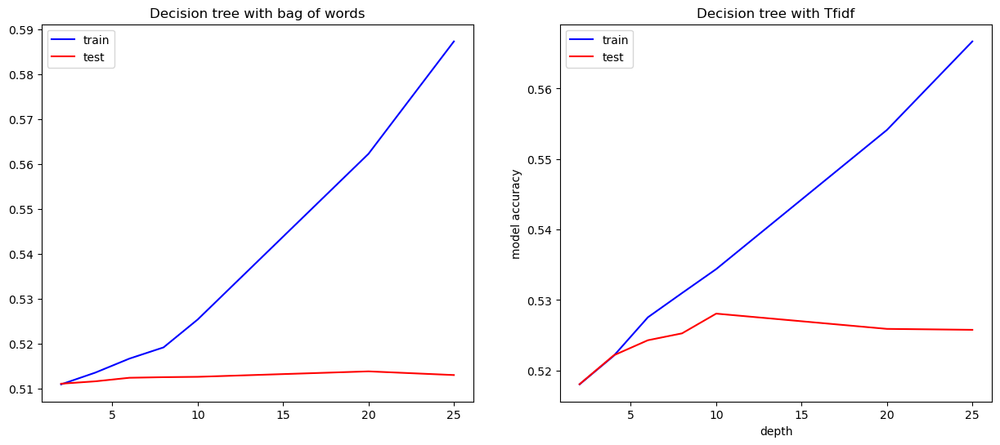

In [24]:
plt.figure()
plt.subplots(1,2, figsize =(15,6))

plt.subplot(1,2,1)
plt.plot(depths, train_accu_Dt_bgw, c='b', label='train')
plt.plot(depths, test_accu_Dt_bgw, c='r', label='test')
plt.legend()
plt.title("Decision tree with bag of words")

plt.subplot(1,2,2)
plt.plot(depths, train_accu_Dt_tfidf, c='b', label='train')
plt.plot(depths, test_accu_Dt_tfidf, c='r', label='test')
plt.xlabel('depth')
plt.ylabel('model accuracy')
plt.legend()
plt.title("Decision tree with Tfidf")


In this model the same as logistic regression, models with TFIDF are working slightly better and the best depth is around 10.

## KNN
Lets try KNN as well. However as dataset is huge and KNN is very heavy in terms of computational power, we just run it for 10 neighbors and on nagofwords.

In [25]:
knn = KNeighborsClassifier(n_neighbors=10)
knn.fit(X_train_transformed_bgw, y_train)

KNeighborsClassifier(n_neighbors=10)

In [26]:
knn.score(X_train_transformed_bgw,y_train)

0.5523536013732092

In [27]:
knn.score(X_test_transformed_bgw,y_test)

0.49706876518432447

In general, all of our models till here are not good predictors of average rating base on the description column. Lets add more features to the model and see if the accuracy improves.


## Model using all the features

Now we will choose all of our columns;split our data; transform the non numeric ones; combine with other numeric ones; then scale and finaly run models.

In [17]:
# `description` column tokenizer


#import:
#stemmer
import nltk
stemmer = nltk.stem.PorterStemmer()
# import stopwords
nltk.download('stopwords')
from nltk.corpus import stopwords 
# import punctuation list
import string

#remove digit
def removedigits(s):
    result = ''.join([i for i in s if not i.isdigit()])
    return result

def removebadcharacters(s):
    s = s.replace('\r','')
    s = s.replace('\n','')
    s = s.replace('\nPs','')
    s = s.replace('\ni','')
    s = s.replace('\nthi','')
    return s
    

#add some stopwords
ENGLISH_STOP_WORDS = stopwords.words('english')

# define custome tokenizer
def my_tokenizer(sentence):
    
    #remove numbers
    sentence = removedigits(sentence)
    sentence = removebadcharacters(sentence)
    
    # remove punctuation and set to lower case
    for punctuation_mark in string.punctuation:
        sentence = sentence.replace(punctuation_mark,'').lower()

    # split sentence into words
    listofwords = sentence.split(' ')
    listofstemmed_words = []
    
    # remove stopwords and any tokens that are just empty strings
    for word in listofwords:
        if (not word in ENGLISH_STOP_WORDS) and (word!=''):
            # Stem words
            stemmed_word = stemmer.stem(word)
            listofstemmed_words.append(stemmed_word)

    return listofstemmed_words




[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/Arianayazdi/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [18]:
#change column type Keywords, RecipeIngredientParts

def set_to_string (s):
    try:
        rec = ''
        for i in range(len(s)):
            rec = rec + s[i] + ', '
        return rec
    except:
        return 'Nan'
    
df_balance["Keywords"] = df_balance["Keywords"].apply(lambda x: set_to_string(x))
df_balance["RecipeIngredientParts"] = df_balance["RecipeIngredientParts"].apply(lambda x: set_to_string(x))

In [33]:
# choose X and Y
X = df_balance[['Description','RecipeCategory', 'Keywords','RecipeIngredientParts',
        'Calories', 'FatContent', 'SaturatedFatContent', 
        'CholesterolContent',
       'SodiumContent', 'CarbohydrateContent', 'FiberContent', 'SugarContent',
       'ProteinContent', 'PrepTimeHours',
       'CookingTimeHours', 'TotalTimeHours']]
y = df_balance["Target"]

#first split to avoid data leakage
#split to test and train and stratify with rating
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=25,stratify=df_balance["Target"])

In [34]:
#Sanity check the size
X_train.shape

(151470, 16)

In [35]:
#text columns


#description column transformer
My_normal_TFIDF_vectorizer = TfidfVectorizer(tokenizer = my_tokenizer, min_df = 10, max_df = 0.9)

#keywords and ingredients
My_phrase_vectorizer = TfidfVectorizer(tokenizer=lambda x: x.split(','),min_df=10)


#column transformer
preprocessor = ColumnTransformer(
    transformers=[
        ('RecipeCategory_transform', OneHotEncoder(handle_unknown = 'ignore'), ['RecipeCategory']),
        ('description_transform', My_normal_TFIDF_vectorizer, 'Description'),
        ('keywords_transform', My_phrase_vectorizer, 'Keywords'),
        ('ingredients_transform', My_phrase_vectorizer, 'RecipeIngredientParts')
    ])

In [36]:
#fit the transformer on train; transform train and test

X_train_texts_transformed = preprocessor.fit_transform(X_train)
X_test_texts_transformed = preprocessor.transform(X_test)

In [37]:
#Sanity check the size
X_train_texts_transformed.toarray().shape

(151470, 12299)

In [38]:
#make data frame of transformed columns
X_train_texts_transformed_df = pd.DataFrame(X_train_texts_transformed.toarray(),
                                            columns=preprocessor.get_feature_names())

/Users/arianayazdi/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [47]:
#make data frame of transformed columns
X_test_texts_transformed_df = pd.DataFrame(data = X_test_texts_transformed.toarray(),
                                            columns=preprocessor.get_feature_names())

/Users/arianayazdi/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [39]:
#Sanity check the size
X_train_texts_transformed_df.shape

(151470, 12299)

In [40]:
X_train_texts_transformed_df.head()

,RecipeCategory_transform__x0_< 15 Mins,RecipeCategory_transform__x0_< 30 Mins,RecipeCategory_transform__x0_< 4 Hours,RecipeCategory_transform__x0_< 60 Mins,RecipeCategory_transform__x0_African,RecipeCategory_transform__x0_Apple,RecipeCategory_transform__x0_Artichoke,RecipeCategory_transform__x0_Asian,RecipeCategory_transform__x0_Australian,RecipeCategory_transform__x0_Austrian,RecipeCategory_transform__x0_Avocado,RecipeCategory_transform__x0_Bar Cookie,RecipeCategory_transform__x0_Bass,RecipeCategory_transform__x0_Bath/Beauty,RecipeCategory_transform__x0_Bean Soup,RecipeCategory_transform__x0_Beans,RecipeCategory_transform__x0_Bear,RecipeCategory_transform__x0_Beef Organ Meats,RecipeCategory_transform__x0_Beginner Cook,RecipeCategory_transform__x0_Belgian,RecipeCategory_transform__x0_Berries,RecipeCategory_transform__x0_Beverages,RecipeCategory_transform__x0_Birthday,RecipeCategory_transform__x0_Black Bean Soup,RecipeCategory_transform__x0_Black Beans,RecipeCategory_transform__x0_Brazilian,RecipeCategory_transform__x0_Bread Machine,RecipeCategory_transform__x0_Breads,RecipeCategory_transform__x0_Breakfast,RecipeCategory_transform__x0_Breakfast Casseroles,RecipeCategory_transform__x0_Broil/Grill,RecipeCategory_transform__x0_Brown Rice,RecipeCategory_transform__x0_Brunch,RecipeCategory_transform__x0_Cajun,RecipeCategory_transform__x0_Cambodian,RecipeCategory_transform__x0_Camping,RecipeCategory_transform__x0_Canadian,RecipeCategory_transform__x0_Candy,RecipeCategory_transform__x0_Canning,RecipeCategory_transform__x0_Cantonese,RecipeCategory_transform__x0_Caribbean,RecipeCategory_transform__x0_Catfish,RecipeCategory_transform__x0_Cauliflower,RecipeCategory_transform__x0_Chard,RecipeCategory_transform__x0_Cheese,RecipeCategory_transform__x0_Cheesecake,RecipeCategory_transform__x0_Cherries,RecipeCategory_transform__x0_Chicken,RecipeCategory_transform__x0_Chicken Breast,RecipeCategory_transform__x0_Chicken Crock Pot,RecipeCategory_transform__x0_Chicken Livers,RecipeCategory_transform__x0_Chicken Thigh & Leg,RecipeCategory_transform__x0_Chilean,RecipeCategory_transform__x0_Chinese,RecipeCategory_transform__x0_Chocolate Chip Cookies,RecipeCategory_transform__x0_Chowders,RecipeCategory_transform__x0_Christmas,RecipeCategory_transform__x0_Chutneys,RecipeCategory_transform__x0_Citrus,RecipeCategory_transform__x0_Clear Soup,RecipeCategory_transform__x0_Coconut,RecipeCategory_transform__x0_Collard Greens,RecipeCategory_transform__x0_Colombian,RecipeCategory_transform__x0_Corn,RecipeCategory_transform__x0_Costa Rican,RecipeCategory_transform__x0_Crab,RecipeCategory_transform__x0_Crawfish,RecipeCategory_transform__x0_Creole,RecipeCategory_transform__x0_Cuban,RecipeCategory_transform__x0_Curries,RecipeCategory_transform__x0_Czech,RecipeCategory_transform__x0_Danish,RecipeCategory_transform__x0_Deep Fried,RecipeCategory_transform__x0_Deer,RecipeCategory_transform__x0_Dessert,RecipeCategory_transform__x0_Desserts Fruit,RecipeCategory_transform__x0_Drop Cookies,RecipeCategory_transform__x0_Duck,RecipeCategory_transform__x0_Duck Breasts,RecipeCategory_transform__x0_Dutch,RecipeCategory_transform__x0_Easy,RecipeCategory_transform__x0_Ecuadorean,RecipeCategory_transform__x0_Egg Free,RecipeCategory_transform__x0_Egyptian,RecipeCategory_transform__x0_Elk,RecipeCategory_transform__x0_Ethiopian,RecipeCategory_transform__x0_European,RecipeCategory_transform__x0_Filipino,RecipeCategory_transform__x0_Finnish,RecipeCategory_transform__x0_For Large Groups,RecipeCategory_transform__x0_Free Of...,RecipeCategory_transform__x0_Frozen Desserts,RecipeCategory_transform__x0_Fruit,RecipeCategory_transform__x0_Gelatin,RecipeCategory_transform__x0_Georgian,RecipeCategory_transform__x0_German,RecipeCategory_transform__x0_Goose,RecipeCategory_transform__x0_Grains,RecipeCategory_transform__x0_Greek,RecipeCategory_transform__x0_Greens,RecipeCategory_transform__x0_Gumbo,RecipeCategory_transform__x0_Halibut,RecipeCategory_transform__x0_Halloween,RecipeCategory_transform__

In [41]:
X_train.head()

,Description,RecipeCategory,Keywords,RecipeIngredientParts,Calories,FatContent,SaturatedFatContent,CholesterolContent,SodiumContent,CarbohydrateContent,FiberContent,SugarContent,ProteinContent,PrepTimeHours,CookingTimeHours,TotalTimeHours
66823,Taking rice up a notch without too much more e...,Rice,"Low Cholesterol, Healthy, < 30 Mins, Easy,","olive oil, onion, long-grain rice, chicken bro...",334.0,15.7,1.5,0.0,289.4,41.3,1.5,1.7,7.6,0.166667,0.333333,0.500000
132912,Make and share this Oat Pancakes recipe from F...,Breakfast,"Healthy, < 15 Mins, Easy,","rolled oats, egg, water,",135.0,3.2,0.7,52.9,19.9,20.4,3.0,0.5,6.4,0.083333,0.166667,0.250000
124716,There is nothing better than a creamsicle in a...,Smoothies,"Beverages, Low Protein, Sweet, < 15 Mins, Begi...","low-fat milk, ice cream, vanilla extract,",294.4,11.6,5.9,31.1,149.2,40.5,2.3,36.0,7.0,0.083333,0.050000,0.133333
35073,Giacomo loves it! It's one of his favourite.\r...,Chicken Breast,"Chicken, Poultry, Meat, European, Very Low Car...","chicken breast, cream cheese, olive oil, salt,...",466.6,33.8,12.7,143.3,204.0,2.2,0.1,0.4,37.3,0.100000,0.416667,0.516667
87384,A classic Mediterranean salad dressing that’s ...,Salad Dressings,"Lemon, Citrus, Fruit, European, Low Protein, W...","sea salt, garlic cloves, fresh lemon juice, ex...",998.6,108.0,14.9,0.0,6981.4,13.5,0.7,3.0,1.0,0.166667,0.000000,0.166667


In [42]:
#reset index before concat to avoid dismatching
X_train= X_train.reset_index()
X_test= X_test.reset_index()

Now we have train and test dataframe of our transformed numeric columns. lets combine with other columns.

In [43]:
pd.concat([X_train, X_train_texts_transformed_df], axis=1).shape

(151470, 12316)

In [48]:
X_train = pd.concat([X_train, X_train_texts_transformed_df], axis=1)
X_test = pd.concat([X_test, X_test_texts_transformed_df], axis=1)

In [45]:
#sanity check
X_train.shape

(151470, 12316)

In [46]:
#sanity check
X_train.head()

,index,Description,RecipeCategory,Keywords,RecipeIngredientParts,Calories,FatContent,SaturatedFatContent,CholesterolContent,SodiumContent,CarbohydrateContent,FiberContent,SugarContent,ProteinContent,PrepTimeHours,CookingTimeHours,TotalTimeHours,RecipeCategory_transform__x0_< 15 Mins,RecipeCategory_transform__x0_< 30 Mins,RecipeCategory_transform__x0_< 4 Hours,RecipeCategory_transform__x0_< 60 Mins,RecipeCategory_transform__x0_African,RecipeCategory_transform__x0_Apple,RecipeCategory_transform__x0_Artichoke,RecipeCategory_transform__x0_Asian,RecipeCategory_transform__x0_Australian,RecipeCategory_transform__x0_Austrian,RecipeCategory_transform__x0_Avocado,RecipeCategory_transform__x0_Bar Cookie,RecipeCategory_transform__x0_Bass,RecipeCategory_transform__x0_Bath/Beauty,RecipeCategory_transform__x0_Bean Soup,RecipeCategory_transform__x0_Beans,RecipeCategory_transform__x0_Bear,RecipeCategory_transform__x0_Beef Organ Meats,RecipeCategory_transform__x0_Beginner Cook,RecipeCategory_transform__x0_Belgian,RecipeCategory_transform__x0_Berries,RecipeCategory_transform__x0_Beverages,RecipeCategory_transform__x0_Birthday,RecipeCategory_transform__x0_Black Bean Soup,RecipeCategory_transform__x0_Black Beans,RecipeCategory_transform__x0_Brazilian,RecipeCategory_transform__x0_Bread Machine,RecipeCategory_transform__x0_Breads,RecipeCategory_transform__x0_Breakfast,RecipeCategory_transform__x0_Breakfast Casseroles,RecipeCategory_transform__x0_Broil/Grill,RecipeCategory_transform__x0_Brown Rice,RecipeCategory_transform__x0_Brunch,RecipeCategory_transform__x0_Cajun,RecipeCategory_transform__x0_Cambodian,RecipeCategory_transform__x0_Camping,RecipeCategory_transform__x0_Canadian,RecipeCategory_transform__x0_Candy,RecipeCategory_transform__x0_Canning,RecipeCategory_transform__x0_Cantonese,RecipeCategory_transform__x0_Caribbean,RecipeCategory_transform__x0_Catfish,RecipeCategory_transform__x0_Cauliflower,RecipeCategory_transform__x0_Chard,RecipeCategory_transform__x0_Cheese,RecipeCategory_transform__x0_Cheesecake,RecipeCategory_transform__x0_Cherries,RecipeCategory_transform__x0_Chicken,RecipeCategory_transform__x0_Chicken Breast,RecipeCategory_transform__x0_Chicken Crock Pot,RecipeCategory_transform__x0_Chicken Livers,RecipeCategory_transform__x0_Chicken Thigh & Leg,RecipeCategory_transform__x0_Chilean,RecipeCategory_transform__x0_Chinese,RecipeCategory_transform__x0_Chocolate Chip Cookies,RecipeCategory_transform__x0_Chowders,RecipeCategory_transform__x0_Christmas,RecipeCategory_transform__x0_Chutneys,RecipeCategory_transform__x0_Citrus,RecipeCategory_transform__x0_Clear Soup,RecipeCategory_transform__x0_Coconut,RecipeCategory_transform__x0_Collard Greens,RecipeCategory_transform__x0_Colombian,RecipeCategory_transform__x0_Corn,RecipeCategory_transform__x0_Costa Rican,RecipeCategory_transform__x0_Crab,RecipeCategory_transform__x0_Crawfish,RecipeCategory_transform__x0_Creole,RecipeCategory_transform__x0_Cuban,RecipeCategory_transform__x0_Curries,RecipeCategory_transform__x0_Czech,RecipeCategory_transform__x0_Danish,RecipeCategory_transform__x0_Deep Fried,RecipeCategory_transform__x0_Deer,RecipeCategory_transform__x0_Dessert,RecipeCategory_transform__x0_Desserts Fruit,RecipeCategory_transform__x0_Drop Cookies,RecipeCategory_transform__x0_Duck,RecipeCategory_transform__x0_Duck Breasts,RecipeCategory_transform__x0_Dutch,RecipeCategory_transform__x0_Easy,RecipeCategory_transform__x0_Ecuadorean,RecipeCategory_transform__x0_Egg Free,RecipeCategory_transform__x0_Egyptian,RecipeCategory_transform__x0_Elk,RecipeCategory_transform__x0_Ethiopian,RecipeCategory_transform__x0_European,RecipeCategory_transform__x0_Filipino,RecipeCategory_transform__x0_Finnish,RecipeCategory_transform__x0_For Large Groups,RecipeCategory_transform__x0_Free Of...,RecipeCategory_transform__x0_Frozen Desserts,RecipeCategory_transform__x0_Fruit,RecipeCategory_transform__x0_Gelatin,RecipeCategory_transform__x0_Georgian,RecipeCategory_transform__x0_German,RecipeCategory_transform__x0_Goose,

In [49]:
#sanity check
X_test.head()

,index,Description,RecipeCategory,Keywords,RecipeIngredientParts,Calories,FatContent,SaturatedFatContent,CholesterolContent,SodiumContent,CarbohydrateContent,FiberContent,SugarContent,ProteinContent,PrepTimeHours,CookingTimeHours,TotalTimeHours,RecipeCategory_transform__x0_< 15 Mins,RecipeCategory_transform__x0_< 30 Mins,RecipeCategory_transform__x0_< 4 Hours,RecipeCategory_transform__x0_< 60 Mins,RecipeCategory_transform__x0_African,RecipeCategory_transform__x0_Apple,RecipeCategory_transform__x0_Artichoke,RecipeCategory_transform__x0_Asian,RecipeCategory_transform__x0_Australian,RecipeCategory_transform__x0_Austrian,RecipeCategory_transform__x0_Avocado,RecipeCategory_transform__x0_Bar Cookie,RecipeCategory_transform__x0_Bass,RecipeCategory_transform__x0_Bath/Beauty,RecipeCategory_transform__x0_Bean Soup,RecipeCategory_transform__x0_Beans,RecipeCategory_transform__x0_Bear,RecipeCategory_transform__x0_Beef Organ Meats,RecipeCategory_transform__x0_Beginner Cook,RecipeCategory_transform__x0_Belgian,RecipeCategory_transform__x0_Berries,RecipeCategory_transform__x0_Beverages,RecipeCategory_transform__x0_Birthday,RecipeCategory_transform__x0_Black Bean Soup,RecipeCategory_transform__x0_Black Beans,RecipeCategory_transform__x0_Brazilian,RecipeCategory_transform__x0_Bread Machine,RecipeCategory_transform__x0_Breads,RecipeCategory_transform__x0_Breakfast,RecipeCategory_transform__x0_Breakfast Casseroles,RecipeCategory_transform__x0_Broil/Grill,RecipeCategory_transform__x0_Brown Rice,RecipeCategory_transform__x0_Brunch,RecipeCategory_transform__x0_Cajun,RecipeCategory_transform__x0_Cambodian,RecipeCategory_transform__x0_Camping,RecipeCategory_transform__x0_Canadian,RecipeCategory_transform__x0_Candy,RecipeCategory_transform__x0_Canning,RecipeCategory_transform__x0_Cantonese,RecipeCategory_transform__x0_Caribbean,RecipeCategory_transform__x0_Catfish,RecipeCategory_transform__x0_Cauliflower,RecipeCategory_transform__x0_Chard,RecipeCategory_transform__x0_Cheese,RecipeCategory_transform__x0_Cheesecake,RecipeCategory_transform__x0_Cherries,RecipeCategory_transform__x0_Chicken,RecipeCategory_transform__x0_Chicken Breast,RecipeCategory_transform__x0_Chicken Crock Pot,RecipeCategory_transform__x0_Chicken Livers,RecipeCategory_transform__x0_Chicken Thigh & Leg,RecipeCategory_transform__x0_Chilean,RecipeCategory_transform__x0_Chinese,RecipeCategory_transform__x0_Chocolate Chip Cookies,RecipeCategory_transform__x0_Chowders,RecipeCategory_transform__x0_Christmas,RecipeCategory_transform__x0_Chutneys,RecipeCategory_transform__x0_Citrus,RecipeCategory_transform__x0_Clear Soup,RecipeCategory_transform__x0_Coconut,RecipeCategory_transform__x0_Collard Greens,RecipeCategory_transform__x0_Colombian,RecipeCategory_transform__x0_Corn,RecipeCategory_transform__x0_Costa Rican,RecipeCategory_transform__x0_Crab,RecipeCategory_transform__x0_Crawfish,RecipeCategory_transform__x0_Creole,RecipeCategory_transform__x0_Cuban,RecipeCategory_transform__x0_Curries,RecipeCategory_transform__x0_Czech,RecipeCategory_transform__x0_Danish,RecipeCategory_transform__x0_Deep Fried,RecipeCategory_transform__x0_Deer,RecipeCategory_transform__x0_Dessert,RecipeCategory_transform__x0_Desserts Fruit,RecipeCategory_transform__x0_Drop Cookies,RecipeCategory_transform__x0_Duck,RecipeCategory_transform__x0_Duck Breasts,RecipeCategory_transform__x0_Dutch,RecipeCategory_transform__x0_Easy,RecipeCategory_transform__x0_Ecuadorean,RecipeCategory_transform__x0_Egg Free,RecipeCategory_transform__x0_Egyptian,RecipeCategory_transform__x0_Elk,RecipeCategory_transform__x0_Ethiopian,RecipeCategory_transform__x0_European,RecipeCategory_transform__x0_Filipino,RecipeCategory_transform__x0_Finnish,RecipeCategory_transform__x0_For Large Groups,RecipeCategory_transform__x0_Free Of...,RecipeCategory_transform__x0_Frozen Desserts,RecipeCategory_transform__x0_Fruit,RecipeCategory_transform__x0_Gelatin,RecipeCategory_transform__x0_Georgian,RecipeCategory_transform__x0_German,RecipeCategory_transform__x0_Goose,

In [40]:
#drop numeric columns
X_train.drop(columns=['index','RecipeCategory','Description','Keywords','RecipeIngredientParts'],inplace=True)
X_test.drop(columns=['index','RecipeCategory','Description','Keywords','RecipeIngredientParts'],inplace=True)

For running our models we can make use of pipelines, which enables us to tune our hyperprameters easier using gridsearch and take care of normalizing the train and test set without leakage, and finaly helps us to add pca in further steps.

In [50]:
#check for nul values
X_train.isna().sum()

index                                         0
Description                                   0
RecipeCategory                                0
Keywords                                      0
RecipeIngredientParts                         0
                                             ..
ingredients_transform__yogurt                 0
ingredients_transform__yukon gold potato      0
ingredients_transform__yukon gold potatoes    0
ingredients_transform__ziti pasta             0
ingredients_transform__zucchini               0
Length: 12316, dtype: int64

In [51]:
#define the pipline with logistic regression model
estimators = [
#    ('scaler', StandardScaler()), 
#    ('PCA',PCA()),
    ('model', LogisticRegression(C=0.01))
]

my_pipe = Pipeline(estimators)

We can search for the best model between different c values and scalers and number of PCA.

In [ ]:
#my_pipe.fit(X_train, y_train)
#print(f'Test score: {my_pipe.score(X_test, y_test)}')

In [ ]:
#params = {'model__C': [0.01,0.1], 
#          'scaler': [StandardScaler(), None, MinMaxScaler()],
#         }

Unfortunatly, the computer is not powerful enough to handle this huge dataset. so lets just focus on more important columns and drop description column.

In [19]:
# choose X and Y
X = df_balance[['RecipeCategory', 'Keywords','RecipeIngredientParts',
        'Calories', 'FatContent', 'SaturatedFatContent', 
        'CholesterolContent',
       'SodiumContent', 'CarbohydrateContent', 'FiberContent', 'SugarContent',
       'ProteinContent', 'PrepTimeHours',
       'CookingTimeHours', 'TotalTimeHours']]
y = df_balance["Target"]

#first split to avoid data leakage
#split to test and train and stratify with rating
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=25,stratify=df_balance["Target"])

In [20]:
#Sanity check the size
X_train.shape

(151470, 15)

In [21]:
#text columns


#description column transformer
My_normal_TFIDF_vectorizer = TfidfVectorizer(tokenizer = my_tokenizer, min_df = 10, max_df = 0.9)

#keywords and ingredients
My_phrase_vectorizer = TfidfVectorizer(tokenizer=lambda x: x.split(','),min_df=10)


#column transformer
preprocessor = ColumnTransformer(
    transformers=[
        ('RecipeCategory_transform', OneHotEncoder(handle_unknown = 'ignore'), ['RecipeCategory']),
        ('keywords_transform', My_phrase_vectorizer, 'Keywords'),
        ('ingredients_transform', My_phrase_vectorizer, 'RecipeIngredientParts')
    ])

In [22]:
#fit the transformer on train; transform train and test

X_train_texts_transformed = preprocessor.fit_transform(X_train)
X_test_texts_transformed = preprocessor.transform(X_test)

In [23]:
#Sanity check the size
X_train_texts_transformed.toarray().shape

(151470, 4553)

By ignoring discription column, number of columns after transforming has reduced from 12K to 4K. So it should be easier for computer to run.


In [24]:
#make data frame of transformed columns
X_train_texts_transformed_df = pd.DataFrame(X_train_texts_transformed.toarray(),
                                            columns=preprocessor.get_feature_names())

/Users/arianayazdi/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [25]:
#make data frame of transformed columns
X_test_texts_transformed_df = pd.DataFrame(data = X_test_texts_transformed.toarray(),
                                            columns=preprocessor.get_feature_names())

/Users/arianayazdi/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [26]:
#Sanity check the size
X_train_texts_transformed_df.shape

(151470, 4553)

In [27]:
#reset index before concat to avoid dismatching
X_train= X_train.reset_index()
X_test= X_test.reset_index()

lets combine with other columns.

In [28]:
#sanity check
pd.concat([X_train, X_train_texts_transformed_df], axis=1).shape

(151470, 4569)

In [29]:
X_train = pd.concat([X_train, X_train_texts_transformed_df], axis=1)
X_test = pd.concat([X_test, X_test_texts_transformed_df], axis=1)

In [30]:
#sanity check
X_train.shape

(151470, 4569)

In [31]:
#sanity check
X_train.head()

,index,RecipeCategory,Keywords,RecipeIngredientParts,Calories,FatContent,SaturatedFatContent,CholesterolContent,SodiumContent,CarbohydrateContent,FiberContent,SugarContent,ProteinContent,PrepTimeHours,CookingTimeHours,TotalTimeHours,RecipeCategory_transform__x0_< 15 Mins,RecipeCategory_transform__x0_< 30 Mins,RecipeCategory_transform__x0_< 4 Hours,RecipeCategory_transform__x0_< 60 Mins,RecipeCategory_transform__x0_African,RecipeCategory_transform__x0_Apple,RecipeCategory_transform__x0_Artichoke,RecipeCategory_transform__x0_Asian,RecipeCategory_transform__x0_Australian,RecipeCategory_transform__x0_Austrian,RecipeCategory_transform__x0_Avocado,RecipeCategory_transform__x0_Bar Cookie,RecipeCategory_transform__x0_Bass,RecipeCategory_transform__x0_Bath/Beauty,RecipeCategory_transform__x0_Bean Soup,RecipeCategory_transform__x0_Beans,RecipeCategory_transform__x0_Bear,RecipeCategory_transform__x0_Beef Organ Meats,RecipeCategory_transform__x0_Beginner Cook,RecipeCategory_transform__x0_Belgian,RecipeCategory_transform__x0_Berries,RecipeCategory_transform__x0_Beverages,RecipeCategory_transform__x0_Birthday,RecipeCategory_transform__x0_Black Bean Soup,RecipeCategory_transform__x0_Black Beans,RecipeCategory_transform__x0_Brazilian,RecipeCategory_transform__x0_Bread Machine,RecipeCategory_transform__x0_Breads,RecipeCategory_transform__x0_Breakfast,RecipeCategory_transform__x0_Breakfast Casseroles,RecipeCategory_transform__x0_Broil/Grill,RecipeCategory_transform__x0_Brown Rice,RecipeCategory_transform__x0_Brunch,RecipeCategory_transform__x0_Cajun,RecipeCategory_transform__x0_Cambodian,RecipeCategory_transform__x0_Camping,RecipeCategory_transform__x0_Canadian,RecipeCategory_transform__x0_Candy,RecipeCategory_transform__x0_Canning,RecipeCategory_transform__x0_Cantonese,RecipeCategory_transform__x0_Caribbean,RecipeCategory_transform__x0_Catfish,RecipeCategory_transform__x0_Cauliflower,RecipeCategory_transform__x0_Chard,RecipeCategory_transform__x0_Cheese,RecipeCategory_transform__x0_Cheesecake,RecipeCategory_transform__x0_Cherries,RecipeCategory_transform__x0_Chicken,RecipeCategory_transform__x0_Chicken Breast,RecipeCategory_transform__x0_Chicken Crock Pot,RecipeCategory_transform__x0_Chicken Livers,RecipeCategory_transform__x0_Chicken Thigh & Leg,RecipeCategory_transform__x0_Chilean,RecipeCategory_transform__x0_Chinese,RecipeCategory_transform__x0_Chocolate Chip Cookies,RecipeCategory_transform__x0_Chowders,RecipeCategory_transform__x0_Christmas,RecipeCategory_transform__x0_Chutneys,RecipeCategory_transform__x0_Citrus,RecipeCategory_transform__x0_Clear Soup,RecipeCategory_transform__x0_Coconut,RecipeCategory_transform__x0_Collard Greens,RecipeCategory_transform__x0_Colombian,RecipeCategory_transform__x0_Corn,RecipeCategory_transform__x0_Costa Rican,RecipeCategory_transform__x0_Crab,RecipeCategory_transform__x0_Crawfish,RecipeCategory_transform__x0_Creole,RecipeCategory_transform__x0_Cuban,RecipeCategory_transform__x0_Curries,RecipeCategory_transform__x0_Czech,RecipeCategory_transform__x0_Danish,RecipeCategory_transform__x0_Deep Fried,RecipeCategory_transform__x0_Deer,RecipeCategory_transform__x0_Dessert,RecipeCategory_transform__x0_Desserts Fruit,RecipeCategory_transform__x0_Drop Cookies,RecipeCategory_transform__x0_Duck,RecipeCategory_transform__x0_Duck Breasts,RecipeCategory_transform__x0_Dutch,RecipeCategory_transform__x0_Easy,RecipeCategory_transform__x0_Ecuadorean,RecipeCategory_transform__x0_Egg Free,RecipeCategory_transform__x0_Egyptian,RecipeCategory_transform__x0_Elk,RecipeCategory_transform__x0_Ethiopian,RecipeCategory_transform__x0_European,RecipeCategory_transform__x0_Filipino,RecipeCategory_transform__x0_Finnish,RecipeCategory_transform__x0_For Large Groups,RecipeCategory_transform__x0_Free Of...,RecipeCategory_transform__x0_Frozen Desserts,RecipeCategory_transform__x0_Fruit,RecipeCategory_transform__x0_Gelatin,RecipeCategory_transform__x0_Georgian,RecipeCategory_transform__x0_German,RecipeCategory_transform__x0_Goose,RecipeCatego

In [32]:
#sanity check
X_test.head()

,index,RecipeCategory,Keywords,RecipeIngredientParts,Calories,FatContent,SaturatedFatContent,CholesterolContent,SodiumContent,CarbohydrateContent,FiberContent,SugarContent,ProteinContent,PrepTimeHours,CookingTimeHours,TotalTimeHours,RecipeCategory_transform__x0_< 15 Mins,RecipeCategory_transform__x0_< 30 Mins,RecipeCategory_transform__x0_< 4 Hours,RecipeCategory_transform__x0_< 60 Mins,RecipeCategory_transform__x0_African,RecipeCategory_transform__x0_Apple,RecipeCategory_transform__x0_Artichoke,RecipeCategory_transform__x0_Asian,RecipeCategory_transform__x0_Australian,RecipeCategory_transform__x0_Austrian,RecipeCategory_transform__x0_Avocado,RecipeCategory_transform__x0_Bar Cookie,RecipeCategory_transform__x0_Bass,RecipeCategory_transform__x0_Bath/Beauty,RecipeCategory_transform__x0_Bean Soup,RecipeCategory_transform__x0_Beans,RecipeCategory_transform__x0_Bear,RecipeCategory_transform__x0_Beef Organ Meats,RecipeCategory_transform__x0_Beginner Cook,RecipeCategory_transform__x0_Belgian,RecipeCategory_transform__x0_Berries,RecipeCategory_transform__x0_Beverages,RecipeCategory_transform__x0_Birthday,RecipeCategory_transform__x0_Black Bean Soup,RecipeCategory_transform__x0_Black Beans,RecipeCategory_transform__x0_Brazilian,RecipeCategory_transform__x0_Bread Machine,RecipeCategory_transform__x0_Breads,RecipeCategory_transform__x0_Breakfast,RecipeCategory_transform__x0_Breakfast Casseroles,RecipeCategory_transform__x0_Broil/Grill,RecipeCategory_transform__x0_Brown Rice,RecipeCategory_transform__x0_Brunch,RecipeCategory_transform__x0_Cajun,RecipeCategory_transform__x0_Cambodian,RecipeCategory_transform__x0_Camping,RecipeCategory_transform__x0_Canadian,RecipeCategory_transform__x0_Candy,RecipeCategory_transform__x0_Canning,RecipeCategory_transform__x0_Cantonese,RecipeCategory_transform__x0_Caribbean,RecipeCategory_transform__x0_Catfish,RecipeCategory_transform__x0_Cauliflower,RecipeCategory_transform__x0_Chard,RecipeCategory_transform__x0_Cheese,RecipeCategory_transform__x0_Cheesecake,RecipeCategory_transform__x0_Cherries,RecipeCategory_transform__x0_Chicken,RecipeCategory_transform__x0_Chicken Breast,RecipeCategory_transform__x0_Chicken Crock Pot,RecipeCategory_transform__x0_Chicken Livers,RecipeCategory_transform__x0_Chicken Thigh & Leg,RecipeCategory_transform__x0_Chilean,RecipeCategory_transform__x0_Chinese,RecipeCategory_transform__x0_Chocolate Chip Cookies,RecipeCategory_transform__x0_Chowders,RecipeCategory_transform__x0_Christmas,RecipeCategory_transform__x0_Chutneys,RecipeCategory_transform__x0_Citrus,RecipeCategory_transform__x0_Clear Soup,RecipeCategory_transform__x0_Coconut,RecipeCategory_transform__x0_Collard Greens,RecipeCategory_transform__x0_Colombian,RecipeCategory_transform__x0_Corn,RecipeCategory_transform__x0_Costa Rican,RecipeCategory_transform__x0_Crab,RecipeCategory_transform__x0_Crawfish,RecipeCategory_transform__x0_Creole,RecipeCategory_transform__x0_Cuban,RecipeCategory_transform__x0_Curries,RecipeCategory_transform__x0_Czech,RecipeCategory_transform__x0_Danish,RecipeCategory_transform__x0_Deep Fried,RecipeCategory_transform__x0_Deer,RecipeCategory_transform__x0_Dessert,RecipeCategory_transform__x0_Desserts Fruit,RecipeCategory_transform__x0_Drop Cookies,RecipeCategory_transform__x0_Duck,RecipeCategory_transform__x0_Duck Breasts,RecipeCategory_transform__x0_Dutch,RecipeCategory_transform__x0_Easy,RecipeCategory_transform__x0_Ecuadorean,RecipeCategory_transform__x0_Egg Free,RecipeCategory_transform__x0_Egyptian,RecipeCategory_transform__x0_Elk,RecipeCategory_transform__x0_Ethiopian,RecipeCategory_transform__x0_European,RecipeCategory_transform__x0_Filipino,RecipeCategory_transform__x0_Finnish,RecipeCategory_transform__x0_For Large Groups,RecipeCategory_transform__x0_Free Of...,RecipeCategory_transform__x0_Frozen Desserts,RecipeCategory_transform__x0_Fruit,RecipeCategory_transform__x0_Gelatin,RecipeCategory_transform__x0_Georgian,RecipeCategory_transform__x0_German,RecipeCategory_transform__x0_Goose,RecipeCatego

In [33]:
#drop numeric columns
X_train.drop(columns=['index','RecipeCategory','Keywords','RecipeIngredientParts'],inplace=True)
X_test.drop(columns=['index','RecipeCategory','Keywords','RecipeIngredientParts'],inplace=True)

In [35]:
#define the pipline with logistic regression model
estimators = [
#    ('scaler', StandardScaler()), 
#    ('PCA',PCA()),
    ('model', LogisticRegression(C=0.01))
]

my_pipe = Pipeline(estimators)

In [36]:
my_pipe.fit(X_train, y_train)
print(f'Test score: {my_pipe.score(X_test, y_test)}')

/Users/arianayazdi/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Test score: 0.5342241470370762


The score is 53 percent which is not good at all. lets try with normalization.

In [37]:
#define the pipline with logistic regression model
estimators = [
    ('scaler', StandardScaler()), 
#   ('PCA',PCA()),
    ('model', LogisticRegression(C=0.01))
]

my_pipe = Pipeline(estimators)

In [38]:
my_pipe.fit(X_train, y_train)
print(f'Test score: {my_pipe.score(X_test, y_test)}')

Test score: 0.5563536495193832


Normalizing data improved accuracy by 2%.

In [39]:
#define the pipline with logistic regression model
estimators = [
    ('scaler', StandardScaler()), 
   ('PCA',PCA(n_components=4)),
    ('model', LogisticRegression(C=0.01))
]

my_pipe = Pipeline(estimators)

In [40]:
my_pipe.fit(X_train, y_train)
print(f'Test score: {my_pipe.score(X_test, y_test)}')

Test score: 0.5563536495193832


As we see the logistic regression model is not predicting with good accuracy. we can check the model for just numeric columns and droping the columns have multicolinearity (refering to cleaning notebook)

In [5]:
df_balance = pd.read_parquet("Transformed Data/ Recipedf_balanced.parquet")

Lets choose the numeric columns with no multicolinearity along with review counts to check if adding number of reviews to the model helps or not.

In [15]:
# choose X and Y
X = df_balance[['Calories','TotalTimeHours','ProteinContent','ReviewCount']]
y = df_balance["Target"]

#first split to avoid data leakage
#split to test and train and stratify with rating
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=25,stratify=df_balance["Target"])

In [14]:
df_balance.columns

Index(['RecipeId', 'Name', 'AuthorId', 'AuthorName', 'DatePublished',
       'Description', 'Images', 'RecipeCategory', 'Keywords',
       'RecipeIngredientQuantities', 'RecipeIngredientParts',
       'AggregatedRating', 'ReviewCount', 'Calories', 'FatContent',
       'SaturatedFatContent', 'CholesterolContent', 'SodiumContent',
       'CarbohydrateContent', 'FiberContent', 'SugarContent', 'ProteinContent',
       'RecipeInstructions', 'PrepTimeHours', 'CookingTimeHours',
       'TotalTimeHours', 'CaloriesCategory', 'rateTwoScale', 'Target'],
      dtype='object')

In [16]:
#define the pipline with logistic regression model
estimators = [
    ('scaler', StandardScaler()), 
#    ('PCA',PCA(n_components=4)),
    ('model', LogisticRegression(C=0.01))
]

my_pipe = Pipeline(estimators)

In [17]:
my_pipe.fit(X_train, y_train)
print(f'Test score: {my_pipe.score(X_test, y_test)}')

Test score: 0.5549540509137002


Nothing to say :)

Lets tune hyperprameter, do Kfold cross validation and finaly see precision and recal in addition to accuracy.

In [23]:
#grid search

from sklearn.model_selection import GridSearchCV

#params to optimize
params = {'scaler': [StandardScaler(), None]
          ,'model__C': [0.001,0.01,0.1,1]}
          
          
grid_search = GridSearchCV(my_pipe, param_grid=params, cv=5)

#fit all train dataset
fitted_search = grid_search.fit(X_train, y_train)

In [25]:
#confusion_matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

y_pred = fitted_search.predict(X_test)



,Predicted Good-rating,Predicted Bad_rating
True Good-rating,15080,3854
True Bad_rating,12993,5941


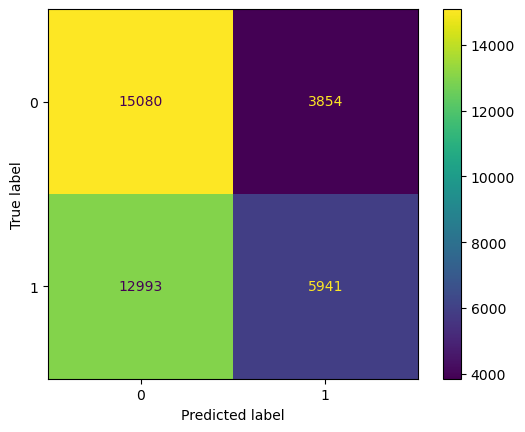

In [27]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

y_pred = fitted_search.predict(X_test)

# Generate confusion matrix
cf_matrix = confusion_matrix(y_test, y_pred)

# label rows and columns
cf_df = pd.DataFrame(
    cf_matrix, 
    columns=["Predicted Good-rating", "Predicted Bad_rating"],
    index=["True Good-rating", "True Bad_rating"]
)

display(cf_df)

ConfusionMatrixDisplay.from_estimator(fitted_search, X_test, y_test)

In [28]:
from sklearn.metrics import classification_report

report_initial = classification_report(y_test, y_pred)
print(report_initial)

              precision    recall  f1-score   support

           0       0.54      0.80      0.64     18934
           1       0.61      0.31      0.41     18934

    accuracy                           0.56     37868
   macro avg       0.57      0.56      0.53     37868
weighted avg       0.57      0.56      0.53     37868



By choosing the best hyper-parameters the overall accuracy has improved 1% more percent.
Our precision score for both of classes are not good. however the recall score for the class zero is not bad. It means that while the model is not able to predict good recipes, it can find 80% of bad recipes. 